# (EPSILON)-Final project
># Eye disorders prevalence
>* Vision and Eye Health Surveillance is a de-identified summary table of vision and eye health data indicators from Medicare claims, stratified by all available combinations of age group, race/ethnicity, gender, and state. Medicare claims for VEHSS includes beneficiaries who were fully enrolled in Medicare Part B Fee-for-Service (FFS) for the duration of the year. Medicare claims provide a convenience sample that includes approximately 30 million individuals annually, which represents nearly 89% of the US population aged 65 and older and 3.3% of the US population younger than 65, including persons disabled due to blindness.

In [44]:
# Import Libraries
import numpy as np 
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
from datasist.structdata import detect_outliers
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import warnings
# Suppress all warnings
warnings.filterwarnings('ignore')

## Get the data ready

In [87]:
# Read the data
df=pd.read_csv(r"c:\Users\DELL\Downloads\Medicaid_Claims__MAX__-_Vision_and_Eye_Health_Surveillance.csv")
# Display the first 5 rows of the dataframe
df.head(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Category,Question,Response,Age,...,QuestionID,ResponseID,DataValueTypeID,AgeID,GenderID,RaceEthnicityID,RiskFactorID,RiskFactorResponseID,Geolocation,Geographic Level
0,2019,2019,ND,North Dakota,Medicaid,Eye Health Conditions,Cornea Disorders,Annual prevalence of diagnosed cornea disorders,Keratoconus,40-64 years,...,QDXDC16,R16_1,CRDPREV,AGE4064,GALL,OTH,RFALL,RFTOT,POINT (-100.1184210489 47.475319779),NaN
1,2019,2019,ND,North Dakota,Medicaid,Eye Health Conditions,Cornea Disorders,Annual prevalence of diagnosed cornea disorders,Keratoconus,40 years and older,...,QDXDC16,R16_1,CRDPREV,AGE40PLUS,GALL,UNK,RFALL,RFTOT,POINT (-100.1184210489 47.475319779),NaN
2,2019,2019,NE,Nebraska,Medicaid,Eye Health Conditions,Cornea Disorders,Annual prevalence of diagnosed cornea disorders,Keratoconus,40-64 years,...,QDXDC16,R16_1,CRDPREV,AGE4064,GF,UNK,RFALL,RFTOT,POINT (-99.36572062299 41.641040988),NaN
3,2019,2019,WI,Wisconsin,Medicaid,Eye Health Conditions,Cornea Disorders,Annual prevalence of diagnosed cornea disorders,Keratoconus,18 years and older,...,QDXDC16,R16_1,CRDPREV,AGE18PLUS,GM,ALLRACE,RFALL,RFTOT,POINT (-89.81637074199 44.393191174),NaN
4,2019,2019,WY,Wyoming,Medicaid,Eye Health Conditions,Cornea Disorders,Annual prevalence of diagnosed cornea disorders,Keratoconus,0-17 years,...,QDXDC16,R16_1,CRDPREV,AGE017,GF,AIAN,RFALL,RFTOT,POINT (-108.1098303529 43.235541343),NaN


In [46]:
# show the data shape
df.shape

(700000, 36)

In [47]:
# Show column names
df.columns

Index(['YearStart', 'YearEnd', 'LocationAbbr', 'LocationDesc', 'DataSource',
       'Topic', 'Category', 'Question', 'Response', 'Age', 'Gender',
       'RaceEthnicity', 'RiskFactor', 'RiskFactorResponse', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_limit', 'High_Confidence_Limit',
       'Numerator', 'Sample_Size', 'LocationID', 'TopicID', 'CategoryID',
       'QuestionID', 'ResponseID', 'DataValueTypeID', 'AgeID', 'GenderID',
       'RaceEthnicityID', 'RiskFactorID', 'RiskFactorResponseID',
       'Geolocation', 'Geographic Level'],
      dtype='object')

In [48]:
# Standardize column names by converting them to lowercase and replacing spaces with underscores
df.columns=df.columns.str.strip().str.lower()
df.columns = df.columns.str.replace(' ', '_', regex= True)

## Data cleaning

In [49]:
# Show number of unique values for columns.
df[["yearstart","yearend","datasource","topic","riskfactor","riskfactorresponse",
    "data_value_unit","data_value_type","data_value_footnote_symbol","data_value_footnote",
    "topicid","datavaluetypeid","riskfactorid","riskfactorresponseid"]].nunique()

yearstart                     1
yearend                       1
datasource                    1
topic                         1
riskfactor                    1
riskfactorresponse            1
data_value_unit               1
data_value_type               1
data_value_footnote_symbol    1
data_value_footnote           1
topicid                       1
datavaluetypeid               1
riskfactorid                  1
riskfactorresponseid          1
dtype: int64

In [50]:
# Show the unique values of category.
df["category"].value_counts()

category
Other Retinal Disorders                                111972
Age Related Macular Degeneration                        93310
Infectious and Inflammatory Diseases                    74648
Diabetic Eye Diseases                                   74648
Glaucoma                                                65492
Orbital and External Disease                            65317
Cornea Disorders                                        55986
Other Visual Disturbances                               46655
Injury, Burns and Surgical Complications of the Eye     37324
Disorders of Optic Nerve and Visual Pathways            27993
Cancer and Neoplasms of the Eye                         27993
Retinal Detachment and Defects                           9331
Other Eye Disorders                                      9331
Name: count, dtype: int64

In [51]:
# Dropping unwanted columns
df.drop(["yearstart","yearend","locationabbr","question","datasource","topic","riskfactor","riskfactorresponse",
         "data_value_type","data_value_footnote_symbol","data_value_footnote",
         "topicid","categoryid","questionid","responseid","ageid","genderid","raceethnicityid",
         "datavaluetypeid","riskfactorid","riskfactorresponseid","geographic_level"],axis=1,inplace=True)

In [52]:
# show descriptive statistics for the data
df.describe()

,data_value,low_confidence_limit,high_confidence_limit,numerator,sample_size,locationid
count,527762.000000,527762.000000,527762.000000,2.647270e+05,5.277620e+05,700000.000000
mean,0.541174,0.385119,1.404946,1.539000e+03,2.115128e+05,30.435607
std,1.230868,0.914890,2.466290,1.793242e+04,1.500950e+06,16.223266
min,0.000000,0.000000,0.000000,1.000000e+01,1.000000e+01,4.000000
25%,0.000000,0.000000,0.080000,3.000000e+01,9.700000e+02,17.000000
50%,0.060000,0.030000,0.400000,1.000000e+02,1.180000e+04,30.000000
75%,0.500000,0.330000,1.540000,4.200000e+02,8.850000e+04,41.000000
max,40.000000,21.130000,61.330000,3.560500e+06,6.950200e+07,72.000000


In [53]:
# Show summary inf about data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700000 entries, 0 to 699999
Data columns (total 14 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   locationdesc           700000 non-null  object 
 1   category               700000 non-null  object 
 2   response               700000 non-null  object 
 3   age                    700000 non-null  object 
 4   gender                 700000 non-null  object 
 5   raceethnicity          700000 non-null  object 
 6   data_value_unit        700000 non-null  object 
 7   data_value             527762 non-null  float64
 8   low_confidence_limit   527762 non-null  float64
 9   high_confidence_limit  527762 non-null  float64
 10  numerator              264727 non-null  float64
 11  sample_size            527762 non-null  float64
 12  locationid             700000 non-null  int64  
 13  geolocation            683625 non-null  object 
dtypes: float64(5), int64(1), object(8)
m

In [54]:
# Rename ('data_value') column.
df.rename(columns={'data_value': 'data_value(%)'}, inplace=True)

In [55]:
# Drrop data_value_unit column.
df.drop(["data_value_unit"],axis=1,inplace=True)

In [56]:
# Split 'Geolocation' into 'Longitude' and 'Latitude'
df['longitude'] = df['geolocation'].str.extract(r'POINT \((-?\d+\.\d+)\s')
df['latitude'] = df['geolocation'].str.extract(r'POINT \(-?\d+\.\d+\s(-?\d+\.\d+)\)')

# Convert to float for further analysis
df['longitude'] = df['longitude'].astype(float)
df['latitude'] = df['latitude'].astype(float)

In [57]:
# Drrop geolocation column.
df.drop(["geolocation"],axis=1,inplace=True)

In [58]:
# Show the number of duplicated rows
df.duplicated().sum()

0

In [59]:
# Show null values
missing_values = df.isnull().sum()
print(missing_values)

locationdesc                  0
category                      0
response                      0
age                           0
gender                        0
raceethnicity                 0
data_value(%)            172238
low_confidence_limit     172238
high_confidence_limit    172238
numerator                435273
sample_size              172238
locationid                    0
longitude                 16375
latitude                  16375
dtype: int64


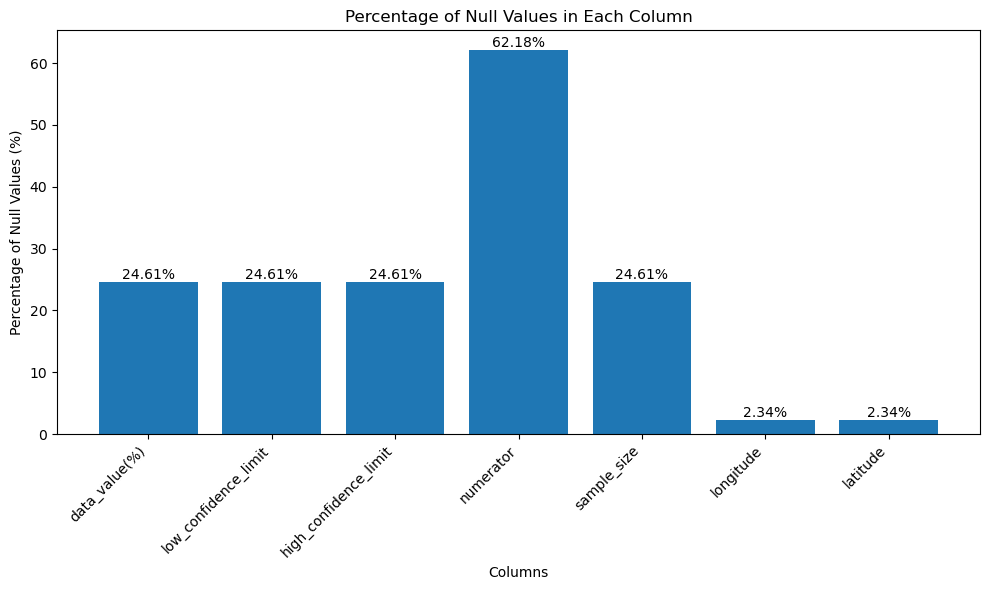

In [60]:
# Calculate the percentage of null values for each column
null_percentage = df.isnull().mean() * 100

# Filter out columns that do not have any null values
null_percentage = null_percentage[null_percentage > 0]

# Create a bar chart for the percentage of null values
plt.figure(figsize=(10, 6))
bars=plt.bar(null_percentage.index, null_percentage)
plt.title('Percentage of Null Values in Each Column')
plt.xlabel('Columns')
plt.ylabel('Percentage of Null Values (%)')
plt.xticks(rotation=45, ha='right')
# Annotate each bar with its value
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.2f}%', ha='center', va='bottom')
plt.tight_layout()
plt.show()

In [61]:
df.shape

(700000, 14)

In [62]:
# List of columns to check for null values
null_columns = ['data_value(%)', 'low_confidence_limit', 'high_confidence_limit', 'sample_size']

# Remove rows with null values in any of the specified columns
df.dropna(subset=null_columns, inplace=True)

# Reset the index if necessary
df.reset_index(drop=True, inplace=True)

In [63]:
df.shape

(527762, 14)

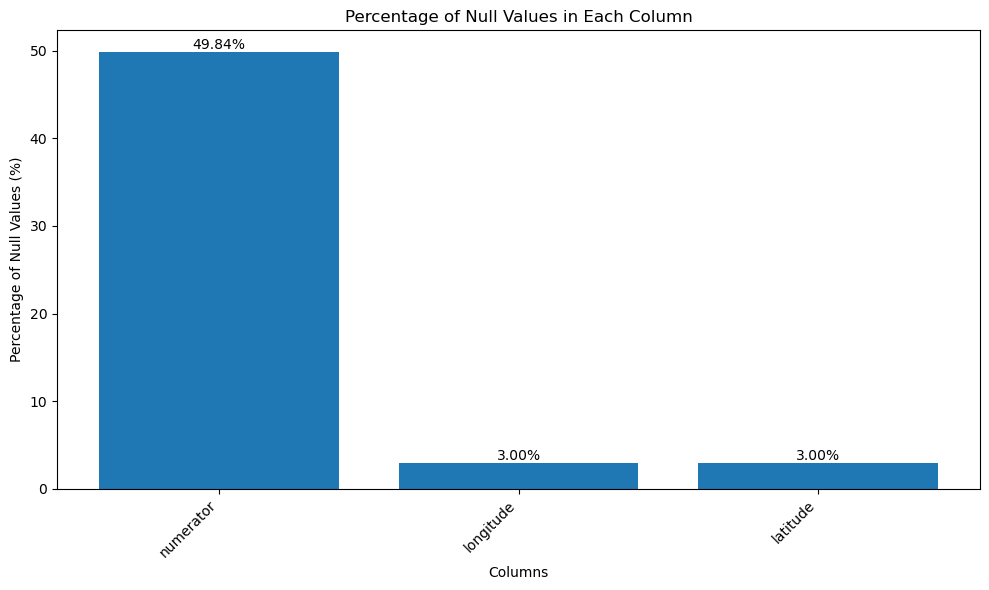

In [64]:
# Calculate the percentage of null values for each column
null_percentage = df.isnull().mean() * 100

# Filter out columns that do not have any null values
null_percentage = null_percentage[null_percentage > 0]

# Create a bar chart for the percentage of null values
plt.figure(figsize=(10, 6))
bars=plt.bar(null_percentage.index, null_percentage)
plt.title('Percentage of Null Values in Each Column')
plt.xlabel('Columns')
plt.ylabel('Percentage of Null Values (%)')
plt.xticks(rotation=45, ha='right')
# Annotate each bar with its value
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.2f}%', ha='center', va='bottom')
plt.tight_layout()
plt.show()

In [65]:
# Calculate the median per location
group_means_location = df.groupby('locationdesc')['numerator'].transform('median')
df['numerator'].fillna(group_means_location, inplace=True)

In [66]:
# Calculate the mean latitude for each neighbourhood
fill_lat = df.groupby('locationid')['latitude'].mean()

# Calculate the mean longitude for each neighbourhood
fill_long = df.groupby('locationid')['longitude'].mean()

# Fill missing values in the 'long' column with the mean longitude
df.longitude.fillna(fill_long, inplace=True)

# Fill missing values in the 'lat' column with the mean latitude
df.latitude.fillna(fill_lat, inplace=True)

In [67]:
# Check the rows with the specific LocationID that has null values
missing_location = df[df['locationid'] == 59]

In [68]:
# calculates the mean latitude and longitude values
lat_val = missing_location['latitude'].mean()
long_val = missing_location['longitude'].mean()

In [70]:
# fill null values in the 'latitude,longitude' column with the calculated mean value.
df.latitude.fillna(lat_val,inplace=True)
df.longitude.fillna(long_val,inplace=True)

In [71]:
# Show null values
missing_values = df.isnull().sum()
print(missing_values)

locationdesc             0
category                 0
response                 0
age                      0
gender                   0
raceethnicity            0
data_value(%)            0
low_confidence_limit     0
high_confidence_limit    0
numerator                0
sample_size              0
locationid               0
longitude                0
latitude                 0
dtype: int64


## Feature Engineering

In [ ]:
# show box plot for numeric columns: ['data_value(%)', 'low_confidence_limit', 'high_confidence_limit','numerator', 'sample_size']
numeric_data = ['data_value(%)', 'low_confidence_limit', 'high_confidence_limit','numerator', 'sample_size']

for j in numeric_data:
    fig = px.box(df, y=j)
    fig.show()

In [74]:
# choosing only numeric columns
numeric_columns = df.select_dtypes(include=['number']).columns

# get indexes of outliers
outliers_indices = detect_outliers(df, 0, numeric_columns)

# show lengths of outliers
len(outliers_indices)

209225

In [75]:
# Check the number of rows where 'data_value(%)' is geater than 20
print((df['data_value(%)'] > 20).sum())

# Filter out rows where 'data_value(%)' is greater than 20
df = df[df['data_value(%)'] <= 20]

# Check the number of rows where 'numerator' is greater than 600000
print((df['numerator'] > 600000).sum())

# Filter out rows where 'numerator' is greater than 600000
df = df[df['numerator'] <= 600000]


30
31


In [76]:
# Filter the DataFrame for rows where sample_size greeater than or equal to 20000000.0
filtered_rows = df[df['sample_size'] >= 20000000.0]

# Display the filtered rows
filtered_rows.head(5)

,locationdesc,category,response,age,gender,raceethnicity,data_value(%),low_confidence_limit,high_confidence_limit,numerator,sample_size,locationid,longitude,latitude
39,National,Other Visual Disturbances,Color blindness,All ages,Female,All races,0.00,0.00,0.00,1400.0,37598800.0,59,-82.404260,40.060210
157,National,Other Visual Disturbances,Visual field defect,All ages,Male,All races,0.06,0.05,0.06,17600.0,31903200.0,59,-87.350837,39.431134
210,National,Diabetic Eye Diseases,Non-proliferative,All ages,Female,All races,0.23,0.23,0.24,87800.0,37598800.0,59,-87.350837,39.431134
231,National,Age Related Macular Degeneration,Geographic atrophy,All ages,Male,All races,0.00,0.00,0.00,770.0,31903200.0,59,-87.350837,39.431134
832,National,Cornea Disorders,Other corneal disorders,All ages,Female,All races,0.12,0.12,0.12,45100.0,37598800.0,59,-87.350837,39.431134


In [77]:
# Display thee shape of the filtered rows.
filtered_rows.shape

(588, 14)

In [78]:
# # Show the unique values of locationdesc
filtered_rows['locationdesc'].value_counts()

locationdesc
National    588
Name: count, dtype: int64

In [80]:
# Filter the DataFrame for rows where data_value(%) is not within the confidence limits
filtered_rows_2 = df[(df['data_value(%)'] < df['low_confidence_limit']) | (df['data_value(%)'] > df['high_confidence_limit'])]

# Output the shape of the filtered DataFrame
filtered_rows_2.shape

(0, 14)

In [84]:
# Perform the stratified sampling
stratify_col = df['category']
df_sample, _ = train_test_split(df, stratify=stratify_col, train_size=70000/len(df), random_state=42)

In [85]:
df.shape

(527701, 14)

create a smaller sample from the original dataset and ensuring that the distribution of categories in the sample is similar to the distribution in the original dataset.

In [86]:
df_sample.shape

(70000, 14)

## EXPLORATORY DATA ANALYSIS (EDA)

### Distribution Analysis

In [114]:
# Visualize the distribution of data_value(%)
fig = px.histogram(df_sample, x='data_value(%)',color_discrete_sequence=px.colors.qualitative.Set3, nbins=50, title='Distribution of Data Value (%)')
fig.show()

In [115]:
# Visualize the distribution of numerator
fig = px.histogram(df_sample, x='numerator',color_discrete_sequence=px.colors.qualitative.Set3, nbins=50, title='Distribution of Numerator')
fig.show()

In [116]:
# Visualize the distribution of sample_size
fig = px.histogram(df_sample, x='sample_size',color_discrete_sequence=px.colors.qualitative.Set3, nbins=50, title='Distribution of Sample Size')
fig.show()

### prevalence analysis

In [94]:
# Calculate the mean prevalence for each state
mean_prevalence = df_sample.groupby('locationdesc', as_index=False)['data_value(%)'].mean()

# Create a bar chart for mean prevalence across different states
fig = px.bar(mean_prevalence, x='locationdesc', y='data_value(%)', title='Mean Prevalence Across Different States',
             color_discrete_sequence=px.colors.qualitative.Set3,
             labels={'locationdesc': 'State', 'data_value(%)': 'Mean Prevalence (%)'})

# Sort the bars in descending order of mean prevalence
fig.update_layout(xaxis={'categoryorder': 'total descending'})
fig.show()

New jersey is the most prevalent state. It has a higher prevalence than other states.
Wyoming is the least prevalent state. It has a lower prevalence than other states.

#### Is the prevelance of eye disorders effected by age ,gender and race?

In [98]:
# Calculate the mean prevalence for each age group
mean_prevalence_age = df_sample.groupby('age', as_index=False)['data_value(%)'].mean()

# Create a bar chart for mean prevalence across different age groups
fig = px.bar(mean_prevalence_age, x='age', y='data_value(%)', title='Mean Prevalence Across Different Age Groups',
             color_discrete_sequence=px.colors.qualitative.Set3,
             labels={'age': 'Age Group', 'data_value(%)': 'Mean Prevalence (%)'})

# Sort the bars in descending order of mean prevalence
fig.update_layout(xaxis={'categoryorder': 'total descending'})
fig.show()

Those who are between the ages of 65:48 have the highest prevelance rate, while the ages of 18:39 are the least susceptible to this diseases.

In [104]:
# Group by 'gender' and calculate the mean of 'data_value(%)'
gender_group_analysis = df_sample.groupby('gender')['data_value(%)'].mean().reset_index()

fig = px.bar(gender_group_analysis,
             x='gender', 
             y='data_value(%)', 
             color='data_value(%)', 
             color_continuous_scale='Viridis', 
             title='Prevalence of eye disorders by Gender')

fig.show()

The prevelance of the diseases in female is higher than males.

In [100]:
# Group by 'raceethnicity' and calculate the mean of 'data_value(%)'
race_group_analysis = df_sample.groupby('raceethnicity')['data_value(%)'].mean().reset_index()

fig = px.bar(race_group_analysis,
             x='raceethnicity', 
             y='data_value(%)', 
             color='data_value(%)', 
             color_continuous_scale='Viridis', 
             title='Prevalence of eye disorders by Race/Ethnicity')

fig.show()

All races have similar ratiose of eye disorders, except North American Native ,which is the least.

### Eye disorders (Category) analysis

#### 1. Univariate Analysis

In [ ]:
# Count of each eye disorder in the category column
category_counts = df_sample['category'].value_counts().reset_index()
category_counts.columns = ['Category', 'Count']

In [56]:
# Bar plot of Eye Disorders
fig = px.bar(category_counts, x='Category', y='Count', color='Category', 
             title='Frequency Distribution of Eye Disorders', 
             color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(xaxis_title='Eye Disorder Category', yaxis_title='Count')
fig.show()

Other retinal disorders are prevalent.

In [57]:
# Pie chart of Eye Disorders
fig = px.pie(category_counts, values='Count', names='Category', 
             title='Proportion of Eye Disorders Categories',
             color_discrete_sequence=px.colors.qualitative.Set3)
fig.show()

Age Related Macular Degeneration is the highest disorderr prevalence with 13.3%

In [111]:
# Box Plot for data_value(%) across different eye disorder categories
fig = px.box(df_sample, x='category', y='data_value(%)', color='category',
             title='Box Plot of Data Value (%) by Eye Disorder Category',
             color_discrete_sequence=px.colors.qualitative.Set3)

fig.update_layout(xaxis_title='Eye Disorder Category', yaxis_title='Data Value (%)')
fig.show()


####  2. Bivariate Analysis

In [110]:
# Group by category and age to see how the prevalence of different eye disorders varies by age group.
age_category_counts = df_sample.groupby(['category', 'age']).size().reset_index(name='Count')

# Stacked Bar Plot
fig = px.bar(age_category_counts, x='age', y='Count', color='category', 
             title='Distribution of Eye Disorders by Age Group', 
             barmode='stack', 
             color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(xaxis_title='Age Group', yaxis_title='Count')
fig.show()

In [112]:
# Group by category and gender To analyze the prevalence of eye disorders across different genders.
gender_category_counts = df_sample.groupby(['category', 'gender']).size().reset_index(name='Count')

# Grouped Bar Plot
fig = px.bar(gender_category_counts, x='category', y='Count', color='gender', 
             title='Distribution of Eye Disorders by Gender', 
             barmode='group', 
             color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(xaxis_title='Eye Disorder Category', yaxis_title='Count')
fig.show()

In [113]:
# Scatter plot
fig = px.scatter(df_sample, x='data_value(%)', y='response', color='category',orientation='h',
                 title='Prevalence of Eye Disorders by Response',
                 color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(xaxis_title='Response', yaxis_title='Data Value (%)')
fig.show()

### Geographical Analysis

In [72]:
# Scatter plot for latitude and longitude using Plotly
fig = px.scatter(df_sample, x='longitude', y='latitude', color_discrete_sequence=px.colors.qualitative.Set3,
                 title='Spatial Distribution of eye disorders prevalence', labels={'long': 'Longitude', 'lat': 'Latitude'})

fig.show()

In [109]:
# Combine latitude and longitude into a single array
coordinates = df_sample[['latitude', 'longitude']].values

# Perform K-means clustering
kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(coordinates)

# Visualize the clusters
fig = px.scatter_mapbox(df_sample, lat='latitude', lon='longitude', color=cluster_labels,
                        color_continuous_scale='Viridis',
                        title='Cluster Analysis of eye disorders prevalence',
                        hover_name='locationdesc',
                        mapbox_style='carto-positron', zoom=2)
fig.update_layout(margin={'r':0,'t':0,'l':0,'b':0})
fig.show()

### Correlation Analysis

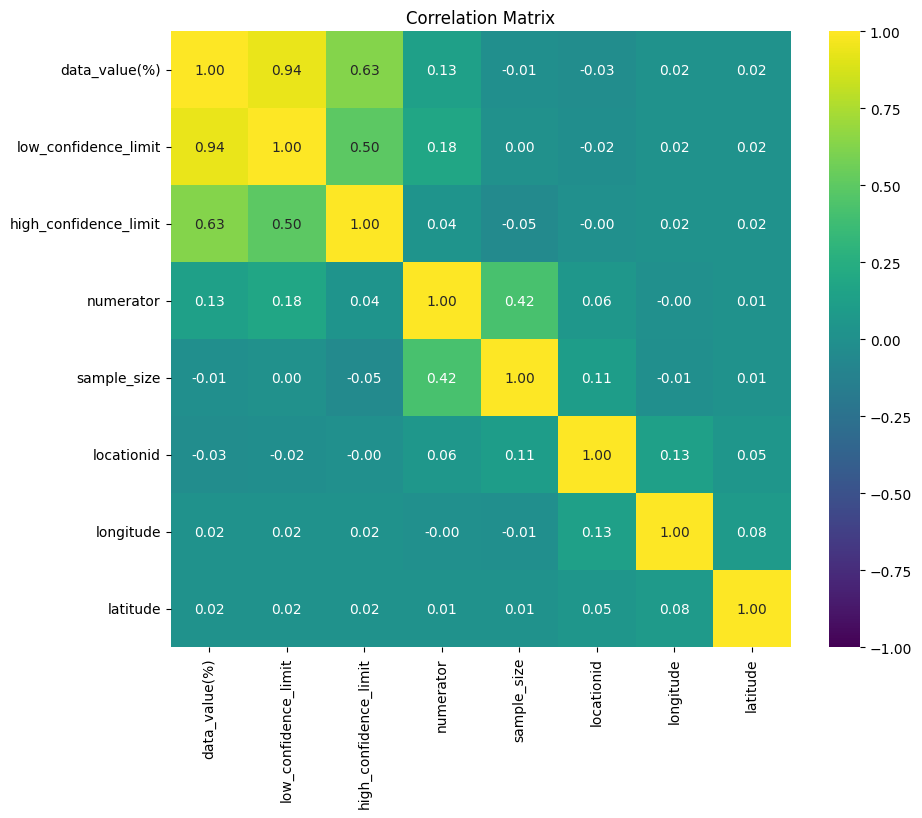

In [83]:
# Calculate the correlation matrix
numeric_cols = df_sample.select_dtypes(include=['float64', 'int64'])
corr_matrix = numeric_cols.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='viridis', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

### Multivariate Analysis

In [107]:
# Scatter plot for multivariate analysis
fig = px.scatter(df_sample,
                 x='data_value(%)', 
                 y='sample_size', 
                 color='age',  # Color by age to add another dimension
                 size='numerator',  # Size points by 'numerator'
                 color_continuous_scale='Viridis', 
                 title='Multivariate Analysis: Prevalence vs Sample Size by Age')

fig.show()

In [108]:
# Parallel coordinates plot for multivariate analysis
fig = px.parallel_coordinates(df_sample, 
                              dimensions=['data_value(%)', 'numerator', 'sample_size', 'low_confidence_limit', 'high_confidence_limit'], 
                              color='data_value(%)', 
                              color_continuous_scale='Viridis', 
                              title='Multivariate Analysis Using Parallel Coordinates')

fig.show()